# EGFR Bioactivities

## Importing datasets and cleaning up the dataframes

In [1]:
%matplotlib inline
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest,chi2,f_regression,VarianceThreshold
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score,accuracy_score
import numpy as np

In [2]:
from google.colab import files
files.upload()

Saving EGFR_bioactivities-tr.csv to EGFR_bioactivities-tr.csv


{'EGFR_bioactivities-tr.csv': b'CHEMBL ID,AlogP,Smiles,Standard Value,Standard Units\nCHEMBL3655343,4.19,CN(C)C/C=C/C(=O)N1Cc2sc3ncnc(Nc4ccc(F)c(Cl)c4)c3c2C1,12,nM\nCHEMBL3655351,5.62,CN(C/C=C/C(=O)N1CCc2c(sc3ncnc(Nc4cc(O)c(Cl)c(Cl)c4)c23)C1)C(C)(C)C,1,nM\nCHEMBL16,1.97,O=C1N=C(O)NC1(c1ccccc1)c1ccccc1,,\nCHEMBL1200545,2.99,CC(=O)OCC(=O)[C@@]1(OC(C)=O)[C@@H](C)C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C,,\nCHEMBL891,2.55,Cc1onc(-c2ccccc2Cl)c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12,,\nCHEMBL939,4.28,COc1cc2ncnc(Nc3ccc(F)c(Cl)c3)c2cc1OCCCN1CCOCC1,33,nM\nCHEMBL607707,5.1,CCOc1cc2ncc(C#N)c(Nc3ccc(F)c(Cl)c3)c2cc1NC(=O)/C=C/CN(C)C,79983.43,nM\nCHEMBL475594,7.13,CN(C)Cc1ccc(-c2cc3ncnc(Nc4ccc(OCc5cccc(F)c5)c(Cl)c4)c3s2)o1,2,nM\nCHEMBL473428,6.56,OCc1ccc(-c2cc3ncnc(Nc4ccc(OCc5cccc(F)c5)c(Cl)c4)c3s2)o1,3,nM\nCHEMBL473427,7.53,Fc1cccc(COc2ccc(Nc3ncnc4cc(-c5cccs5)sc34)cc2Cl)c1,8,nM\nCHEMBL519757,8.36,Fc1cccc(COc2ccc(Nc3ncnc4sc(-c5ccc(CNCc6ccccc6)o5)cc34)cc2Cl)c1

In [3]:
from google.colab import files
files.upload()

Saving EGFR_descriptors.csv to EGFR_descriptors.csv


{'EGFR_descriptors.csv': b'"SMILES","SlogP","SMR","LabuteASA","TPSA","AMW","ExactMW","NumLipinskiHBA","NumLipinskiHBD","NumRotatableBonds","NumHBD","NumHBA","NumAmideBonds","NumHeteroAtoms","NumHeavyAtoms","NumAtoms","NumStereocenters","NumUnspecifiedStereocenters","NumRings","NumAromaticRings","NumSaturatedRings","NumAliphaticRings","NumAromaticHeterocycles","NumSaturatedHeterocycles","NumAliphaticHeterocycles","NumAromaticCarbocycles","NumSaturatedCarbocycles","NumAliphaticCarbocycles","FractionCSP3","Chi0v","Chi1v","Chi2v","Chi3v","Chi4v","Chi1n","Chi2n","Chi3n","Chi4n","HallKierAlpha","kappa1","kappa2","kappa3","slogp_VSA1","slogp_VSA2","slogp_VSA3","slogp_VSA4","slogp_VSA5","slogp_VSA6","slogp_VSA7","slogp_VSA8","slogp_VSA9","slogp_VSA10","slogp_VSA11","slogp_VSA12","smr_VSA1","smr_VSA2","smr_VSA3","smr_VSA4","smr_VSA5","smr_VSA6","smr_VSA7","smr_VSA8","smr_VSA9","smr_VSA10","peoe_VSA1","peoe_VSA2","peoe_VSA3","peoe_VSA4","peoe_VSA5","peoe_VSA6","peoe_VSA7","peoe_VSA8","peoe_VSA9"

In [4]:
!pip install kora -q
import kora.install.rdkit

     |████████████████████████████████| 57 kB 3.5 MB/s 
     |████████████████████████████████| 60 kB 6.2 MB/s 


In [5]:
import pandas as pd

In [6]:
data=pd.read_csv("EGFR_bioactivities-tr.csv",encoding='utf-8')
data

,CHEMBL ID,AlogP,Smiles,Standard Value,Standard Units
0,CHEMBL3655343,4.19,CN(C)C/C=C/C(=O)N1Cc2sc3ncnc(Nc4ccc(F)c(Cl)c4)...,12.00,nM
1,CHEMBL3655351,5.62,CN(C/C=C/C(=O)N1CCc2c(sc3ncnc(Nc4cc(O)c(Cl)c(C...,1.00,nM
2,CHEMBL16,1.97,O=C1N=C(O)NC1(c1ccccc1)c1ccccc1,NaN,NaN
3,CHEMBL1200545,2.99,CC(=O)OCC(=O)[C@@]1(OC(C)=O)[C@@H](C)C[C@H]2[C...,NaN,NaN
4,CHEMBL891,2.55,Cc1onc(-c2ccccc2Cl)c1C(=O)N[C@@H]1C(=O)N2[C@@H...,NaN,NaN
...,...,...,...,...,...
15258,CHEMBL285063,4.26,C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1,0.70,nM
15259,CHEMBL56543,2.32,N#C/C(=C\c1ccc(O)c(O)c1)C(=O)NCc1ccccc1,501.19,nM
15260,CHEMBL6966,5.09,COc1ccc(CCN(C)CCCC(C#N)(c2ccc(OC)c(OC)c2)C(C)C...,NaN,NaN
15261,CHEMBL1730,-0.62,CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(COC(C)...,NaN,NaN


In [7]:
data=data.dropna(axis="rows")
data

,CHEMBL ID,AlogP,Smiles,Standard Value,Standard Units
0,CHEMBL3655343,4.19,CN(C)C/C=C/C(=O)N1Cc2sc3ncnc(Nc4ccc(F)c(Cl)c4)...,12.00,nM
1,CHEMBL3655351,5.62,CN(C/C=C/C(=O)N1CCc2c(sc3ncnc(Nc4cc(O)c(Cl)c(C...,1.00,nM
5,CHEMBL939,4.28,COc1cc2ncnc(Nc3ccc(F)c(Cl)c3)c2cc1OCCCN1CCOCC1,33.00,nM
6,CHEMBL607707,5.1,CCOc1cc2ncc(C#N)c(Nc3ccc(F)c(Cl)c3)c2cc1NC(=O)...,79983.43,nM
7,CHEMBL475594,7.13,CN(C)Cc1ccc(-c2cc3ncnc(Nc4ccc(OCc5cccc(F)c5)c(...,2.00,nM
...,...,...,...,...,...
15254,CHEMBL553,3.41,C#Cc1cccc(Nc2ncnc3cc(OCCOC)c(OCCOC)cc23)c1,30.00,nM
15257,CHEMBL285063,4.26,C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1,2.00,nM
15258,CHEMBL285063,4.26,C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1,0.70,nM
15259,CHEMBL56543,2.32,N#C/C(=C\c1ccc(O)c(O)c1)C(=O)NCc1ccccc1,501.19,nM


In [8]:
df=data.loc[data['Standard Units']=='nM']
df

,CHEMBL ID,AlogP,Smiles,Standard Value,Standard Units
0,CHEMBL3655343,4.19,CN(C)C/C=C/C(=O)N1Cc2sc3ncnc(Nc4ccc(F)c(Cl)c4)...,12.00,nM
1,CHEMBL3655351,5.62,CN(C/C=C/C(=O)N1CCc2c(sc3ncnc(Nc4cc(O)c(Cl)c(C...,1.00,nM
5,CHEMBL939,4.28,COc1cc2ncnc(Nc3ccc(F)c(Cl)c3)c2cc1OCCCN1CCOCC1,33.00,nM
6,CHEMBL607707,5.1,CCOc1cc2ncc(C#N)c(Nc3ccc(F)c(Cl)c3)c2cc1NC(=O)...,79983.43,nM
7,CHEMBL475594,7.13,CN(C)Cc1ccc(-c2cc3ncnc(Nc4ccc(OCc5cccc(F)c5)c(...,2.00,nM
...,...,...,...,...,...
15254,CHEMBL553,3.41,C#Cc1cccc(Nc2ncnc3cc(OCCOC)c(OCCOC)cc23)c1,30.00,nM
15257,CHEMBL285063,4.26,C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1,2.00,nM
15258,CHEMBL285063,4.26,C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1,0.70,nM
15259,CHEMBL56543,2.32,N#C/C(=C\c1ccc(O)c(O)c1)C(=O)NCc1ccccc1,501.19,nM


This code is for generating the smiles file for calculating descriptors

In [ ]:
'''df_smi=df['Smiles']
df_smi.to_csv('EGFR_smiles.smi',sep='\t',index=False,header=False)'''


In [9]:
df_des=pd.read_csv('EGFR_descriptors.csv')
df_des

,SMILES,SlogP,SMR,LabuteASA,TPSA,AMW,ExactMW,NumLipinskiHBA,NumLipinskiHBD,NumRotatableBonds,...,MQN33,MQN34,MQN35,MQN36,MQN37,MQN38,MQN39,MQN40,MQN41,MQN42
0,CN(C)C/C=C/C(=O)N1Cc2sc3ncnc(Nc4ccc(F)c(Cl)c4)...,4.18740,114.0557,176.173777,61.36,431.924,431.098287,6,1,5,...,0,0,2,2,0,0,0,0,4,2
1,CN(C/C=C/C(=O)N1CCc2c(sc3ncnc(Nc4cc(O)c(Cl)c(C...,5.61850,139.4685,212.565510,81.59,520.486,519.126251,7,2,5,...,0,0,1,3,0,0,0,0,4,2
2,COc1cc2ncnc(Nc3ccc(F)c(Cl)c3)c2cc1OCCCN1CCOCC1,4.27560,118.1537,184.642297,68.74,446.910,446.152097,7,1,8,...,0,0,0,4,0,0,0,0,2,1
3,CCOc1cc2ncc(C#N)c(Nc3ccc(F)c(Cl)c3)c2cc1NC(=O)...,5.09758,128.6434,195.980693,90.28,467.932,467.152431,7,2,8,...,0,0,0,3,0,0,0,0,2,1
4,CN(C)Cc1ccc(-c2cc3ncnc(Nc4ccc(OCc5cccc(F)c5)c(...,7.12800,137.9747,210.510150,63.42,509.006,508.113603,6,1,8,...,0,0,2,3,0,0,0,0,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13797,C#Cc1cccc(Nc2ncnc3cc(OCCOC)c(OCCOC)cc23)c1,3.40510,111.9397,169.532263,74.73,393.443,393.168856,7,1,10,...,0,0,0,3,0,0,0,0,2,1
13798,C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1,4.26040,95.7894,141.143475,66.91,369.222,368.027273,5,2,4,...,0,0,0,3,0,0,0,0,2,1
13799,C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1,4.26040,95.7894,141.143475,66.91,369.222,368.027273,5,2,4,...,0,0,0,3,0,0,0,0,2,1
13800,N#C/C(=C\c1ccc(O)c(O)c1)C(=O)NCc1ccccc1,2.32118,81.6503,127.316036,93.35,294.310,294.100442,5,3,4,...,0,0,0,2,0,0,0,0,0,0


In [10]:
import math
df['pIC50']=df['Standard Value'].apply(lambda x: -1*math.log(x*10e-9))
df

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,CHEMBL ID,AlogP,Smiles,Standard Value,Standard Units,pIC50
0,CHEMBL3655343,4.19,CN(C)C/C=C/C(=O)N1Cc2sc3ncnc(Nc4ccc(F)c(Cl)c4)...,12.00,nM,15.935774
1,CHEMBL3655351,5.62,CN(C/C=C/C(=O)N1CCc2c(sc3ncnc(Nc4cc(O)c(Cl)c(C...,1.00,nM,18.420681
5,CHEMBL939,4.28,COc1cc2ncnc(Nc3ccc(F)c(Cl)c3)c2cc1OCCCN1CCOCC1,33.00,nM,14.924173
6,CHEMBL607707,5.1,CCOc1cc2ncc(C#N)c(Nc3ccc(F)c(Cl)c3)c2cc1NC(=O)...,79983.43,nM,7.131106
7,CHEMBL475594,7.13,CN(C)Cc1ccc(-c2cc3ncnc(Nc4ccc(OCc5cccc(F)c5)c(...,2.00,nM,17.727534
...,...,...,...,...,...,...
15254,CHEMBL553,3.41,C#Cc1cccc(Nc2ncnc3cc(OCCOC)c(OCCOC)cc23)c1,30.00,nM,15.019483
15257,CHEMBL285063,4.26,C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1,2.00,nM,17.727534
15258,CHEMBL285063,4.26,C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1,0.70,nM,18.777356
15259,CHEMBL56543,2.32,N#C/C(=C\c1ccc(O)c(O)c1)C(=O)NCc1ccccc1,501.19,nM,12.203695


In [11]:
df['Active'] = [1 if x >8 else 0 for x in df['pIC50']]
print(df['Active'].value_counts())

1    12691
0     1111
Name: Active, dtype: int64


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [12]:
from google.colab import files
files.upload()


Saving EGFR_combined.csv to EGFR_combined.csv


{'EGFR_combined.csv': b'"Column0","CHEMBL ID","AlogP","Smiles","Standard Value","Standard Units","pIC50","Active","SMILES","SlogP","SMR","LabuteASA","TPSA","AMW","ExactMW","NumLipinskiHBA","NumLipinskiHBD","NumRotatableBonds","NumHBD","NumHBA","NumAmideBonds","NumHeteroAtoms","NumHeavyAtoms","NumAtoms","NumStereocenters","NumUnspecifiedStereocenters","NumRings","NumAromaticRings","NumSaturatedRings","NumAliphaticRings","NumAromaticHeterocycles","NumSaturatedHeterocycles","NumAliphaticHeterocycles","NumAromaticCarbocycles","NumSaturatedCarbocycles","NumAliphaticCarbocycles","FractionCSP3","Chi0v","Chi1v","Chi2v","Chi3v","Chi4v","Chi1n","Chi2n","Chi3n","Chi4n","HallKierAlpha","kappa1","kappa2","kappa3","slogp_VSA1","slogp_VSA2","slogp_VSA3","slogp_VSA4","slogp_VSA5","slogp_VSA6","slogp_VSA7","slogp_VSA8","slogp_VSA9","slogp_VSA10","slogp_VSA11","slogp_VSA12","smr_VSA1","smr_VSA2","smr_VSA3","smr_VSA4","smr_VSA5","smr_VSA6","smr_VSA7","smr_VSA8","smr_VSA9","smr_VSA10","peoe_VSA1","peoe_VS

In [13]:
data=pd.read_csv('EGFR_combined.csv')
data1=data.drop(['Column0','Standard Value','Standard Units','Smiles','pIC50','CHEMBL ID','SMILES'],axis='columns')
data1=data1.mask(data1.eq('None')).dropna()
data1

,AlogP,Active,SlogP,SMR,LabuteASA,TPSA,AMW,ExactMW,NumLipinskiHBA,NumLipinskiHBD,...,MQN33,MQN34,MQN35,MQN36,MQN37,MQN38,MQN39,MQN40,MQN41,MQN42
0,4.19,1,4.18740,114.0557,176.173777,61.36,431.924,431.098287,6,1,...,0,0,2,2,0,0,0,0,4,2
1,5.62,1,5.61850,139.4685,212.565510,81.59,520.486,519.126251,7,2,...,0,0,1,3,0,0,0,0,4,2
2,4.28,1,4.27560,118.1537,184.642297,68.74,446.910,446.152097,7,1,...,0,0,0,4,0,0,0,0,2,1
3,5.1,0,5.09758,128.6434,195.980693,90.28,467.932,467.152431,7,2,...,0,0,0,3,0,0,0,0,2,1
4,7.13,1,7.12800,137.9747,210.510150,63.42,509.006,508.113603,6,1,...,0,0,2,3,0,0,0,0,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13797,3.41,1,3.40510,111.9397,169.532263,74.73,393.443,393.168856,7,1,...,0,0,0,3,0,0,0,0,2,1
13798,4.26,1,4.26040,95.7894,141.143475,66.91,369.222,368.027273,5,2,...,0,0,0,3,0,0,0,0,2,1
13799,4.26,1,4.26040,95.7894,141.143475,66.91,369.222,368.027273,5,2,...,0,0,0,3,0,0,0,0,2,1
13800,2.32,1,2.32118,81.6503,127.316036,93.35,294.310,294.100442,5,3,...,0,0,0,2,0,0,0,0,0,0


## Under sampling of data to maintain class balance

In [14]:
class_0 = data1[data1['Active'] == 0]
class_1 = data1[data1['Active'] == 1]
print('class 0:', class_0.shape)
print('class 1:', class_1.shape)

class_1_under=class_1.sample(1109)
test_under=pd.concat([class_1_under, class_0], axis=0)
test_under

class 0: (1109, 121)
class 1: (12650, 121)


,AlogP,Active,SlogP,SMR,LabuteASA,TPSA,AMW,ExactMW,NumLipinskiHBA,NumLipinskiHBD,...,MQN33,MQN34,MQN35,MQN36,MQN37,MQN38,MQN39,MQN40,MQN41,MQN42
9449,9.45,1,9.45360,194.4783,307.409288,148.11,722.920,722.414231,11,0,...,0,0,0,6,0,0,0,0,8,4
2303,1.75,1,1.74560,56.1180,92.421948,44.76,218.208,218.057909,4,0,...,0,0,2,1,0,0,0,0,2,1
5613,3.17,1,3.17060,101.1882,150.063238,86.19,346.390,346.142976,6,3,...,0,0,1,3,0,0,0,0,2,1
2740,3.68,1,3.68180,141.2181,212.708840,128.37,498.547,498.212787,11,3,...,0,0,1,4,0,0,0,0,2,1
12218,5.39,1,5.39240,178.2705,273.091298,111.05,660.772,660.253018,11,1,...,0,0,1,5,0,0,0,0,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13700,5.16,0,5.16390,93.6637,151.132884,67.60,379.634,377.984194,5,1,...,0,0,2,2,0,0,0,0,2,1
13733,2.71,0,2.71400,69.1491,108.751424,66.76,254.241,254.057909,4,2,...,0,0,1,2,0,0,0,0,2,1
13772,3.33,0,3.33494,113.2886,169.729667,77.23,398.482,398.211804,6,3,...,0,0,2,1,0,0,0,0,2,1
13794,6,0,5.99612,131.6259,190.934425,79.80,431.499,431.174610,6,2,...,0,0,0,5,0,0,0,0,2,1


## Splitting into training and test datasets

In [15]:
y=test_under['Active']
X=test_under.drop(['Active','AlogP'],axis='columns')
X

,SlogP,SMR,LabuteASA,TPSA,AMW,ExactMW,NumLipinskiHBA,NumLipinskiHBD,NumRotatableBonds,NumHBD,...,MQN33,MQN34,MQN35,MQN36,MQN37,MQN38,MQN39,MQN40,MQN41,MQN42
9449,9.45360,194.4783,307.409288,148.11,722.920,722.414231,11,0,10,0,...,0,0,0,6,0,0,0,0,8,4
2303,1.74560,56.1180,92.421948,44.76,218.208,218.057909,4,0,1,0,...,0,0,2,1,0,0,0,0,2,1
5613,3.17060,101.1882,150.063238,86.19,346.390,346.142976,6,3,4,2,...,0,0,1,3,0,0,0,0,2,1
2740,3.68180,141.2181,212.708840,128.37,498.547,498.212787,11,3,7,3,...,0,0,1,4,0,0,0,0,2,1
12218,5.39240,178.2705,273.091298,111.05,660.772,660.253018,11,1,12,1,...,0,0,1,5,0,0,0,0,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13700,5.16390,93.6637,151.132884,67.60,379.634,377.984194,5,1,3,1,...,0,0,2,2,0,0,0,0,2,1
13733,2.71400,69.1491,108.751424,66.76,254.241,254.057909,4,2,1,2,...,0,0,1,2,0,0,0,0,2,1
13772,3.33494,113.2886,169.729667,77.23,398.482,398.211804,6,3,7,3,...,0,0,2,1,0,0,0,0,2,1
13794,5.99612,131.6259,190.934425,79.80,431.499,431.174610,6,2,5,2,...,0,0,0,5,0,0,0,0,2,1


Scaling the descriptors

In [16]:
## Scaling the descriptors
scaler=StandardScaler()
df_scaled=scaler.fit_transform(X)
X_scaled=pd.DataFrame(df_scaled)
X_scaled

,0,1,2,3,4,5,6,7,8,9,...,109,110,111,112,113,114,115,116,117,118
0,3.396811,2.438669,2.698611,1.740495,2.527216,2.531018,1.643668,-1.626357,1.465192,-1.641288,...,-0.12363,-0.098061,-0.931696,2.582479,-0.156462,-0.021238,-0.030042,-0.025758,2.899667,2.210594
1,-1.477920,-1.802792,-1.669856,-1.350152,-1.680052,-1.678808,-1.140186,-1.626357,-1.560376,-1.641288,...,-0.12363,-0.098061,1.499483,-1.726834,-0.156462,-0.021238,-0.030042,-0.025758,-0.045591,-0.057259
2,-0.576714,-0.421156,-0.498605,-0.111202,-0.611530,-0.609691,-0.344799,0.479867,-0.551853,-0.102992,...,-0.12363,-0.098061,0.283893,-0.003109,-0.156462,-0.021238,-0.030042,-0.025758,-0.045591,-0.057259
3,-0.253419,0.805968,0.774331,1.150177,0.656848,0.659624,1.643668,0.479867,0.456669,0.666155,...,-0.12363,-0.098061,0.283893,0.858754,-0.156462,-0.021238,-0.030042,-0.025758,-0.045591,-0.057259
4,0.828407,1.941816,2.001281,0.632228,2.009152,2.012163,1.643668,-0.924282,2.137540,-0.872140,...,-0.12363,-0.098061,0.283893,1.720616,-0.156462,-0.021238,-0.030042,-0.025758,-0.045591,-0.057259
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2213,0.683898,-0.651821,-0.476870,-0.667130,-0.334408,-0.343915,-0.742493,-0.924282,-0.888027,-0.872140,...,-0.12363,-0.098061,1.499483,-0.864971,-0.156462,-0.021238,-0.030042,-0.025758,-0.045591,-0.057259
2214,-0.865480,-1.403321,-1.338046,-0.692250,-1.379682,-1.378319,-1.140186,-0.222208,-1.560376,-0.102992,...,-0.12363,-0.098061,0.283893,-0.864971,-0.156462,-0.021238,-0.030042,-0.025758,-0.045591,-0.057259
2215,-0.472782,-0.050216,-0.098990,-0.379148,-0.177292,-0.175077,-0.344799,0.479867,0.456669,0.666155,...,-0.12363,-0.098061,1.499483,-1.726834,-0.156462,-0.021238,-0.030042,-0.025758,-0.045591,-0.057259
2216,1.210215,0.511917,0.331883,-0.302293,0.097937,0.100062,-0.344799,-0.222208,-0.215679,-0.102992,...,-0.12363,-0.098061,-0.931696,1.720616,-0.156462,-0.021238,-0.030042,-0.025758,-0.045591,-0.057259


In [17]:
X_train,X_test,y_train,y_test= train_test_split(X_scaled, y, test_size=0.2,shuffle=True)


# Building ML models
## 1) Logistic Regression

In [ ]:
from sklearn.linear_model import LogisticRegression
model=LogisticRegression(C=2)
model.fit(X_train,y_train)
y_pred=model.predict(X_test)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


In [ ]:
print(f1_score(y_test,y_pred))
print(accuracy_score(y_test,y_pred))

0.7799043062200959
0.7927927927927928


## 2) Random Forest Classifier

In [ ]:
from sklearn.ensemble import RandomForestClassifier
model=RandomForestClassifier(max_depth=15,n_estimators=200,min_samples_leaf=3)
model.fit(X_train,y_train)
y_pred=model.predict(X_test)


In [ ]:
print(f1_score(y_test,y_pred))
print(accuracy_score(y_test,y_pred))

0.8418491484184915
0.8536036036036037


## 3) K-neighbours Classifier

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
model=KNeighborsClassifier(n_neighbors=7)
model.fit(X_train,y_train)
y_pred=model.predict(X_test)

In [ ]:
print(f1_score(y_test,y_pred))
print(accuracy_score(y_test,y_pred))

0.7817745803357316
0.795045045045045


## 4) SVM classifier

In [ ]:
from sklearn.svm import SVC
model=SVC(C=11)
model.fit(X_train,y_train)
y_pred=model.predict(X_test)


In [ ]:
print(f1_score(y_test,y_pred))
print(accuracy_score(y_test,y_pred))

0.8157248157248158
0.831081081081081


## 5) Naive Bayes Classifier

In [ ]:
from sklearn.naive_bayes import GaussianNB
model=GaussianNB()
model.fit(X_train,y_train)
y_pred=model.predict(X_test)

In [ ]:
print(f1_score(y_test,y_pred))
print(accuracy_score(y_test,y_pred))

0.6981132075471699
0.7117117117117117


## 6) SGD classifier

In [ ]:
from sklearn.linear_model import SGDClassifier
model=SGDClassifier(alpha=0.01,shuffle=False)
model.fit(X_train,y_train)
y_pred=model.predict(X_test)

In [ ]:
print(f1_score(y_test,y_pred))
print(accuracy_score(y_test,y_pred))

0.7951807228915663
0.8085585585585585


## 7) Decision Tree Classifier

In [ ]:
from sklearn.tree import DecisionTreeClassifier
model=DecisionTreeClassifier(max_depth=7,min_samples_leaf=3)
model.fit(X_train,y_train)
y_pred=model.predict(X_test)

In [ ]:
print(f1_score(y_test,y_pred))
print(accuracy_score(y_test,y_pred))

0.7848699763593381
0.795045045045045


## Comparing F1 scores across models

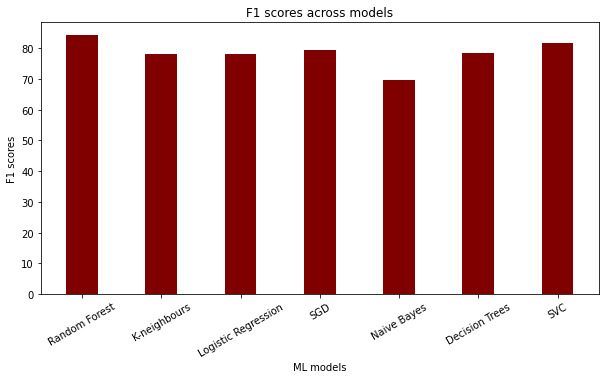

In [ ]:
# creating the dataset
data = {'Random Forest':84.19, 'K-neighbours':78.18, 'Logistic Regression':77.99,
        'SGD':79.52,'Naive Bayes':69.81,'Decision Trees':78.49,'SVC':81.57}
Classifiers = list(data.keys())
R2_scores = list(data.values())
  
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(Classifiers, R2_scores, color ='maroon',
        width = 0.4)
 
plt.xlabel("ML models")
plt.ylabel("F1 scores")
plt.title("F1 scores across models")
plt.xticks(rotation=30)
plt.show()

Random FOrest is the best model with an F score of **84.19%**

## Predicting bioactivity using our best classifier(Random Forest)

In [18]:
from google.colab import files
files.upload()

Saving gen_mols_descriptors.csv to gen_mols_descriptors.csv


{'gen_mols_descriptors.csv': b'"Smiles","SlogP","SMR","LabuteASA","TPSA","AMW","ExactMW","NumLipinskiHBA","NumLipinskiHBD","NumRotatableBonds","NumHBD","NumHBA","NumAmideBonds","NumHeteroAtoms","NumHeavyAtoms","NumAtoms","NumStereocenters","NumUnspecifiedStereocenters","NumRings","NumAromaticRings","NumSaturatedRings","NumAliphaticRings","NumAromaticHeterocycles","NumSaturatedHeterocycles","NumAliphaticHeterocycles","NumAromaticCarbocycles","NumSaturatedCarbocycles","NumAliphaticCarbocycles","FractionCSP3","Chi0v","Chi1v","Chi2v","Chi3v","Chi4v","Chi1n","Chi2n","Chi3n","Chi4n","HallKierAlpha","kappa1","kappa2","kappa3","slogp_VSA1","slogp_VSA2","slogp_VSA3","slogp_VSA4","slogp_VSA5","slogp_VSA6","slogp_VSA7","slogp_VSA8","slogp_VSA9","slogp_VSA10","slogp_VSA11","slogp_VSA12","smr_VSA1","smr_VSA2","smr_VSA3","smr_VSA4","smr_VSA5","smr_VSA6","smr_VSA7","smr_VSA8","smr_VSA9","smr_VSA10","peoe_VSA1","peoe_VSA2","peoe_VSA3","peoe_VSA4","peoe_VSA5","peoe_VSA6","peoe_VSA7","peoe_VSA8","peoe_V

In [20]:
df=pd.read_csv('gen_mols_descriptors.csv')
df1=df.drop('Smiles',axis='columns')
## Scaling the descriptors
scaler=StandardScaler()
df1_scaled=scaler.fit_transform(df1)
df1_scaled=pd.DataFrame(df1_scaled)
df1_scaled

,0,1,2,3,4,5,6,7,8,9,...,109,110,111,112,113,114,115,116,117,118
0,0.025801,1.126417,1.168095,1.067493,1.329513,1.328679,1.453444,-0.162938,1.312785,-0.053683,...,0.0,0.0,-0.282843,-0.242536,0.0,0.0,0.0,0.0,-1.073030,-1.073030
1,0.556486,1.801901,1.537147,0.292054,1.325886,1.329507,0.782624,-0.162938,1.021055,-0.053683,...,0.0,0.0,-1.131371,1.940285,0.0,0.0,0.0,0.0,-0.315597,-0.315597
2,1.729364,0.880436,0.840714,-0.565349,0.823879,0.819230,-0.223607,-0.814688,2.187975,-0.697877,...,0.0,0.0,-1.131371,0.485071,0.0,0.0,0.0,0.0,-0.315597,-0.315597
3,-1.977062,0.703563,0.879595,2.378928,0.975946,0.979871,1.788854,3.095815,-0.729325,3.167286,...,0.0,0.0,1.414214,0.485071,0.0,0.0,0.0,0.0,2.714136,2.714136
4,0.513879,0.065302,0.159999,-0.565349,0.197397,0.192744,-0.223607,-0.814688,0.145865,-0.697877,...,0.0,0.0,-0.282843,0.485071,0.0,0.0,0.0,0.0,0.441836,0.441836
5,-1.153049,-1.077015,-1.159208,-0.344308,-1.285428,-1.281997,-0.559017,0.488813,-0.729325,-0.053683,...,0.0,0.0,0.565685,-0.970143,0.0,0.0,0.0,0.0,-0.315597,-0.315597
6,-0.683640,0.108859,0.230399,1.025674,0.100148,0.103779,0.782624,-0.162938,-0.729325,-0.697877,...,0.0,0.0,-0.282843,1.212678,0.0,0.0,0.0,0.0,1.199269,1.199269
7,-0.800958,-1.615581,-1.662473,-0.715658,-1.777431,-1.774063,-0.894427,-0.162938,-1.021055,-0.053683,...,0.0,0.0,-0.282843,-0.970143,0.0,0.0,0.0,0.0,-0.315597,-0.315597
8,-0.126515,-0.352316,-0.171665,-0.128284,-0.003174,-0.004034,0.111803,-0.162938,-0.145865,-0.053683,...,0.0,0.0,2.262742,-1.697749,0.0,0.0,0.0,0.0,-0.315597,-0.315597
9,0.862078,-0.146691,-0.212394,-0.301055,-0.334017,-0.334726,-0.559017,-0.162938,-0.145865,-0.053683,...,0.0,0.0,-1.131371,0.485071,0.0,0.0,0.0,0.0,-1.073030,-1.073030


In [21]:
from sklearn.ensemble import RandomForestClassifier
model=RandomForestClassifier(max_depth=15,n_estimators=200,min_samples_leaf=3)
model.fit(X_train,y_train)
y_pred=model.predict(df1_scaled)

In [22]:
unique, counts = np.unique(y_pred, return_counts=True)

result = np.column_stack((unique, counts)) 
print (result)

[[0 6]
 [1 6]]


In [23]:
y_pred=pd.DataFrame(y_pred)
df['Activity']=y_pred
df

,Smiles,SlogP,SMR,LabuteASA,TPSA,AMW,ExactMW,NumLipinskiHBA,NumLipinskiHBD,NumRotatableBonds,...,MQN34,MQN35,MQN36,MQN37,MQN38,MQN39,MQN40,MQN41,MQN42,Activity
0,COc1cc(N2CCN(CC(=O)N(C)C)C2=O)ccc1Nc1ncc(Cl)c(...,4.13810,158.3742,243.737899,137.07,602.117,601.187416,12,2,10,...,0,1,3,0,0,0,0,0,0,1
1,C=CC(=O)Nc1cccc(-n2c(=O)c(Cc3ccccc3)cc3cnc(Nc4...,5.00000,179.1964,261.163234,104.62,601.711,601.280138,10,2,9,...,0,0,6,0,0,0,0,2,1,1
2,C=CCCCCCCN1CCOC(COc2cc3ncnc(Nc4ccc(Cl)c(Cl)c4)...,6.90490,150.7917,228.280077,68.74,545.511,544.200796,7,1,13,...,0,0,4,0,0,0,0,2,1,1
3,CN(C)N1C(=O)c2c(c3c4cccc(O)c4n(C4OC(CO)C(O)C(O...,0.88520,145.3395,230.115908,191.95,562.535,562.169978,13,7,3,...,0,3,4,0,0,0,0,10,5,0
4,COc1cc2c(Nc3ccc(Cl)c(Cl)c3)ncnc2cc1OC[C@@H]1CN...,4.93080,125.6647,196.139139,68.74,475.376,474.122546,7,1,6,...,0,1,4,0,0,0,0,4,2,1
5,COc1cccc(-c2cn(C3CCNC3)c3ncnc(N)c23)c1,2.22350,90.4521,133.850767,77.99,309.373,309.158960,6,3,3,...,0,2,2,0,0,0,0,2,1,0
6,COc1ccc2c(c1)cc(C1C(C#N)=C(N)N(c3cccnc3)C3=C1C...,2.98588,127.0074,199.463141,135.32,464.489,464.170922,10,2,3,...,0,1,5,0,0,0,0,6,3,0
7,Cc1ccc(Nc2ncnn3ccc(C)c23)cc1O,2.79534,73.8505,110.088387,62.45,254.293,254.116761,5,2,2,...,0,1,2,0,0,0,0,2,1,0
8,Cc1cn2c(-c3cn[nH]c3)cnc2c(Nc2cc(CN3CCC(F)(F)C3...,3.89072,112.7914,180.479093,87.03,452.922,452.110998,8,2,5,...,0,4,1,0,0,0,0,2,1,1
9,Cc1ccc(NC(=O)c2ccc(Cl)cc2)cc1Nc1nccc(-c2cccnc2)n1,5.49632,119.1299,178.556027,79.80,415.884,415.119988,6,2,5,...,0,0,4,0,0,0,0,0,0,0
